# Segmentation of Indian Traffic

In [1]:
import math
from PIL import Image, ImageDraw
from PIL import ImagePath
import pandas as pd
import os
from os import path
from tqdm import tqdm
import json
import cv2
import numpy as np
import matplotlib.pyplot as plt
import urllib
import imgaug.augmenters as iaa
os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'

In [2]:
# import tensorflow
# physical_devices = tensorflow.config.list_physical_devices('GPU')
# try:
#   tensorflow.config.experimental.set_memory_growth(physical_devices[0], True)
# except:
#   # Invalid device or cannot modify virtual devices once initialized.
#   pass


In [2]:
#Taken help from https://stackoverflow.com/questions/69822304/google-colab-google-drive-can%c2%b4t-be-mounted-anymore-browser-popup-google-dri
!apt-get install -y -qq software-properties-common python-software-properties module-init-tools
!add-apt-repository -y ppa:alessandro-strada/ppa 2>&1 > /dev/null
!apt-get update -qq 2>&1 > /dev/null
!apt-get -y install -qq google-drive-ocamlfuse fuse
from google.colab import auth
auth.authenticate_user()
from oauth2client.client import GoogleCredentials
creds = GoogleCredentials.get_application_default()
import getpass
!google-drive-ocamlfuse -headless -id={creds.client_id} -secret={creds.client_secret} < /dev/null 2>&1 | grep URL
vcode = getpass.getpass()
!echo {vcode} | google-drive-ocamlfuse -headless -id={creds.client_id} -secret={creds.client_secret}
%cd /content
!mkdir drive
%cd drive
!mkdir MyDrive
%cd ..
%cd ..
!google-drive-ocamlfuse /content/drive/MyDrive


E: Package 'python-software-properties' has no installation candidate
Selecting previously unselected package google-drive-ocamlfuse.
(Reading database ... 155222 files and directories currently installed.)
Preparing to unpack .../google-drive-ocamlfuse_0.7.27-0ubuntu1~ubuntu18.04.1_amd64.deb ...
Unpacking google-drive-ocamlfuse (0.7.27-0ubuntu1~ubuntu18.04.1) ...
Setting up google-drive-ocamlfuse (0.7.27-0ubuntu1~ubuntu18.04.1) ...
Processing triggers for man-db (2.8.3-2ubuntu0.1) ...
Please, open the following URL in a web browser: https://accounts.google.com/o/oauth2/auth?client_id=32555940559.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive&response_type=code&access_type=offline&approval_prompt=force
··········
Please, open the following URL in a web browser: https://accounts.google.com/o/oauth2/auth?client_id=32555940559.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope

In [3]:
# from google.colab import drive
# drive.mount('/content/drive')
os.chdir('/content/drive/MyDrive/appliedai/assignment/assignment_29/')

In [ ]:
# !unzip data.zip 

<pre>
1. You can download the data from this link, and extract it

2. All your data will be in the folder "data" 

3. Inside the data you will be having two folders

|--- data
|-----| ---- images
|-----| ------|----- Scene 1
|-----| ------|--------| ----- Frame 1 (image 1)
|-----| ------|--------| ----- Frame 2 (image 2)
|-----| ------|--------| ----- ...
|-----| ------|----- Scene 2
|-----| ------|--------| ----- Frame 1 (image 1)
|-----| ------|--------| ----- Frame 2 (image 2)
|-----| ------|--------| ----- ...
|-----| ------|----- .....
|-----| ---- masks
|-----| ------|----- Scene 1
|-----| ------|--------| ----- json 1 (labeled objects in image 1)
|-----| ------|--------| ----- json 2 (labeled objects in image 1)
|-----| ------|--------| ----- ...
|-----| ------|----- Scene 2
|-----| ------|--------| ----- json 1 (labeled objects in image 1)
|-----| ------|--------| ----- json 2 (labeled objects in image 1)
|-----| ------|--------| ----- ...
|-----| ------|----- .....
</pre>

# Task 1: Preprocessing

## 1. Get all the file name and corresponding json files

In [ ]:
def return_file_names_df(root_dir):
    # write the code that will create a dataframe with two columns ['images', 'json']
    # the column 'image' will have path to images
    # the column 'json' will have path to json files
    l = os.listdir('data/images/')
    files_list = []
    common_dict_for_both_files = dict()
    for i in l:
      filee = os.listdir('data/images/' + i)
      for j in filee:
        files_list.append('data/images/' + os.path.join(i,j))
        common_dict_for_both_files[i + '/' + j[:j.find('_')]] = ['data/images/' + os.path.join(i,j)]

    l1 = os.listdir('data/mask')
    for i in l1:
      fileee = os.listdir('data/mask/' + i)
      for j in fileee:
        common_dict_for_both_files[i + '/' + j[:j.find('_')]].append('data/mask/' + os.path.join(i,j))

    data_df = pd.DataFrame(data=list(common_dict_for_both_files.values()),columns=['images','json'])
    
    return data_df

In [ ]:
root_dir = '/content/drive/MyDrive/appliedai/assignment/assignment_29/'
data_df = return_file_names_df(root_dir)
data_df.head(50)

In [ ]:
data_df.to_csv('raw_data.csv')

> If you observe the dataframe, we can consider each row as single data point, where first feature is image and the second feature is corresponding json file

In [ ]:
data_df = pd.read_csv('raw_data.csv')

In [ ]:
def grader_1(data_df):
    for i in data_df.values:
        if not (path.isfile(i[0]) and path.isfile(i[1]) and i[0][12:i[0].find('_')]==i[1][10:i[1].find('_')]):
            return False
    return True

In [ ]:
grader_1(data_df)

False

## 2. Structure of sample Json file

<img src='https://i.imgur.com/EfR5KmI.png' width="200" height="100">

* Each File will have 3 attributes
    * imgHeight: which tells the height of the image
    * imgWidth: which tells the width of the image
    * objects: it is a list of objects, each object will have multiple attributes,
        * label: the type of the object
        * polygon: a list of two element lists, representing the coordinates of the polygon

#### Compute the unique labels

Let's see how many unique objects are there in the json file.
to see how to get the object from the json file please check <a href='https://www.geeksforgeeks.org/read-json-file-using-python/'>this blog </a>

In [ ]:
def return_unique_labels(data_df):
    # for each file in the column json
    #       read and store all the objects present in that file
    # compute the unique objects and retrun them
    # if open any json file using any editor you will get better sense of it
    unique_labels_dict = list()
    for i in data_df['json']:
      with open(i,'r') as f:
        data = json.load(f)
        for j in data['objects']:
          unique_labels_dict.append(j['label'])

    return list(set(unique_labels_dict))

In [ ]:
unique_labels = return_unique_labels(data_df)

<img src='https://i.imgur.com/L4QH6Tp.png'>

In [4]:
label_clr = {'road':10, 'parking':20, 'drivable fallback':20,'sidewalk':30,'non-drivable fallback':40,'rail track':40,\
                        'person':50, 'animal':50, 'rider':60, 'motorcycle':70, 'bicycle':70, 'autorickshaw':80,\
                        'car':80, 'truck':90, 'bus':90, 'vehicle fallback':90, 'trailer':90, 'caravan':90,\
                        'curb':100, 'wall':100, 'fence':110,'guard rail':110, 'billboard':120,'traffic sign':120,\
                        'traffic light':120, 'pole':130, 'polegroup':130, 'obs-str-bar-fallback':130,'building':140,\
                        'bridge':140,'tunnel':140, 'vegetation':150, 'sky':160, 'fallback background':160,'unlabeled':0,\
                        'out of roi':0, 'ego vehicle':170, 'ground':180,'rectification border':190,\
                   'train':200}

In [ ]:
def grader_2(unique_labels):
    if (not (set(label_clr.keys())-set(unique_labels))) and len(unique_labels) == 40:
        print("True")
    else:
        print("Flase")

grader_2(unique_labels)

True


<pre>
* here we have given a number for each of object types, if you see we are having 21 different set of objects
* Note that we have multiplies each object's number with 10, that is just to make different objects look differently in the segmentation map
* Before you pass it to the models, you might need to devide the image array /10.
</pre>

## 3. Extracting the polygons from the json files

In [ ]:
def get_poly(file):
    # this function will take a file name as argument   
    # it will process all the objects in that file and returns    
    # label: a list of labels for all the objects label[i] will have the corresponding vertices in vertexlist[i]
    # len(label) == number of objects in the image    
    # vertexlist: it should be list of list of vertices in tuple formate 
    # ex: [[(x11,y11), (x12,y12), (x13,y13) .. (x1n,y1n)]
    #     [(x21,y21), (x22,y12), (x23,y23) .. (x2n,y2n)]
    #      .....
    #     [(xm1,ym1), (xm2,ym2), (xm3,ym3) .. (xmn,ymn)]]
    # len(vertexlist) == number of objects in the image    
    # * note that label[i] and vertextlist[i] are corresponds to the same object, one represents the type of the object
    # the other represents the location    
    # width of the image
    # height of the image
    label = []
    vertextlist = []
    with open(file,'r') as f:
      data = json.load(f)
      w = data['imgWidth']
      h = data['imgHeight']
      for i in data['objects']:
        label.append(i['label'])
        vertextlist.append([tuple(vertex) for vertex in i['polygon']])
    return w, h, label, vertextlist

In [ ]:
def grader_3(file):
    w, h, labels, vertexlist = get_poly(file)
    print(len((set(labels)))==18 and len(vertexlist)==227 and w==1920 and h==1080 \
          and isinstance(vertexlist,list) and isinstance(vertexlist[0],list) and isinstance(vertexlist[0][0],tuple) )

grader_3('data/mask/201/frame0029_gtFine_polygons.json')

True


## 4. Creating Image segmentations by drawing set of polygons

### Example

In [ ]:
import math 
from PIL import Image, ImageDraw 
from PIL import ImagePath  
side=8
x1 = [ ((math.cos(th) + 1) *9, (math.sin(th) + 1) * 6) for th in [i * (2 * math.pi) / side for i in range(side)] ]
x2 = [ ((math.cos(th) + 2) *9, (math.sin(th) + 3) *6) for th in [i * (2 * math.pi) / side for i in range(side)] ]

img = Image.new("RGB", (28,28))
img1 = ImageDraw.Draw(img)
# please play with the fill value
# writing the first polygon
img1.polygon(x1, fill =20)
# writing the second polygon
img1.polygon(x2, fill =30)

img=np.array(img)
# note that the filling of the values happens at the channel 1, so we are considering only the first channel here
plt.imshow(img[:,:,0])
print(img.shape)
print(img[:,:,0]//10)
im = Image.fromarray(img[:,:,0])
im.save("test_image.png")

In [ ]:
# !rm -rf data/output

In [ ]:
def compute_masks(data_df):
    # after you have computed the vertexlist plot that polygone in image like this    
    # img = Image.new("RGB", (w, h))
    # img1 = ImageDraw.Draw(img)
    # img1.polygon(vertexlist[i], fill = label_clr[label[i]])    
    # after drawing all the polygons that we collected from json file, 
    # you need to store that image in the folder like this "data/output/scene/framenumber_gtFine_polygons.png"    
    # after saving the image into disk, store the path in a list
    # after storing all the paths, add a column to the data_df['mask'] ex: data_df['mask']= mask_paths
    parent_dir = 'data'
    os.mkdir(os.path.join(parent_dir,'output'))
    new_path = 'data/output'
    folder_inside_data_json = os.listdir('data/mask/')
    for lh in folder_inside_data_json:
      os.mkdir(os.path.join(new_path,lh))
    mask_paths = []  
    for i in data_df['json']:         
      w, h, labels, vertexlist = get_poly(i)
      color_list = []
      img = Image.new("RGB", (w, h))
      img1 = ImageDraw.Draw(img)
      for j in range(len(labels)):
        if len(vertexlist[j])>1:
          img1.polygon(vertexlist[j], fill =label_clr[labels[j]])
      img=np.array(img)
      im = Image.fromarray(img[:,:,0])
      storing_path = os.path.join(new_path,(i[10:-5]+'.png'))
      im.save(storing_path)
      mask_paths.append(storing_path)
    data_df['mask'] =mask_paths  
    return data_df

In [ ]:
data_df = compute_masks(data_df)
data_df.head()

In [ ]:
data_df.drop(labels=['Unnamed: 0'],axis=1,inplace=True)

False
[  0  10  20  40  50  60  70  80  90 100 120 130 140 150 160]
[  0  10  20  40  50  60  70  80  90 100 120 130 140 150 160]


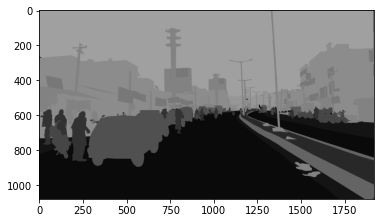

In [ ]:
def grader_3():
    url = "https://i.imgur.com/4XSUlHk.png"
    url_response = urllib.request.urlopen(url)
    img_array = np.array(bytearray(url_response.read()), dtype=np.uint8)
    img = cv2.imdecode(img_array, -1)
    my_img = cv2.imread('data/output/201/frame0029_gtFine_polygons.png')    
    plt.imshow(my_img)
    print((my_img[:,:,0]==img).all())
    print(np.unique(img))
    print(np.unique(my_img[:,:,0]))
    data_df.to_csv('preprocessed_data.csv', index=False)
grader_3()

In [ ]:
# !cp -a /content/drive/MyDrive/appliedai/assignment/assignment_29/preprocessed_data.csv /content/
# !cp -a /content/drive/MyDrive/appliedai/assignment/assignment_29/data /content/
# os.chdir('/content/')

In [5]:
data_df = pd.read_csv('preprocessed_data.csv')

In [6]:
# Deleting the images with zero btye sizes from dataframe
def cleanup(df):
    location_for_deleting_columns = []
    for i in range(df.shape[0]):
        fileSize = os.path.getsize(df['images'][i]) # get integer value size in bytes of the file
        if fileSize == 0:
          location_for_deleting_columns.append(i)
    return data_df.drop(location_for_deleting_columns)
data_df = cleanup(data_df)           

# Task 2: Applying Unet to segment the images

<pre>
* please check the paper: https://arxiv.org/abs/1505.04597

* <img src='https://i.imgur.com/rD4yP7J.jpg' width="500">

* As a part of this assignment we won't writingt this whole architecture, rather we will be doing transfer learning

* please check the library <a hreaf='https://github.com/qubvel/segmentation_models'>https://github.com/qubvel/segmentation_models</a>

* You can install it like this "pip install -U segmentation-models==0.2.1", even in google colab you can install the    same with "!pip install -U segmentation-models==0.2.1" 

* Check the reference notebook in which we have solved one end to end case study of image forgery detection using same  unet

* The number of channels in the output will depend on the number of classes in your data, since we know that we are having 21 classes, the number of channels in the output will also be 21

* <strong>This is where we want you to explore, how do you featurize your created segmentation map note that the original map will be of (w, h, 1) and the output will be (w, h, 21) how will you calculate the loss</strong>, you can check the examples in segmentation github

* please use the loss function that is used in the refence notebooks

</pre>

### Task 2.1: Dice loss

<pre>
* Explain the Dice loss
* 1. Write the formualtion
* 2. Range of the loss function
* 3. Interpretation of loss function
* 4. Write your understanding of the loss function, how does it helps in segmentation
</pre>

### Task 2.2: Training Unet


<pre>
* Split the data into 80:20.
* Train the UNET on the given dataset and plot the train and validation loss.
* As shown in the reference notebook plot 20 images from the test data along with its segmentation map, predicted map.
</pre>

In below code cell taken help from https://github.com/AtharvaMusale/Semantic-Segmentation-on-Indian-Driving-Dataset/blob/main/Semantic%20Segmentation%20On%20IDD.ipynb

& 

reference notebook

In [7]:
!pip install -U segmentation-models

     |████████████████████████████████| 50 kB 6.1 MB/s 


In [8]:
# tf.enable_eager_execution()
import os
import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt
# from hilbert import hilbertCurve
import imgaug.augmenters as iaa
import numpy as np
# import albumentations as A
os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'
import tensorflow as tf
import segmentation_models as sm
from segmentation_models import Unet
sm.set_framework('tf.keras')
tf.keras.backend.set_image_data_format('channels_last')

Segmentation Models: using `keras` framework.


In [9]:
model = Unet('vgg16', encoder_weights='imagenet', classes=21, activation='softmax', input_shape=(256, 256, 3))
model.summary()

58900480/58889256 [==============================] - 1s 0us/step
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 256, 256, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv2 (Conv2D)          (None, 256, 256, 64  36928       ['block1_conv1[0][0]']           
                             

In [10]:
from sklearn.model_selection import train_test_split
X_train, X_test = train_test_split(data_df, test_size=0.15, random_state=42)

In [11]:

aug1 = iaa.Fliplr(1)
aug2 = iaa.Flipud(1)
aug3 = iaa.Emboss(alpha=(1), strength=1)
aug4 = iaa.DirectedEdgeDetect(alpha=(0.8), direction=(1.0))


In [12]:

def visualize(**images):
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        if i==1:
            plt.imshow(image, cmap='gray', vmax=1, vmin=0)
        else:
            plt.imshow(image)
    plt.show()
    
def normalize_image(mask):
    mask = mask/255
    return mask

class Dataset:
    # we will be modifying this CLASSES according to your data/problems
    
    # the parameters needs to changed based on your requirements
    # here we are collecting the file_names because in our dataset, both our images and maks will have same file name
    # ex: fil_name.jpg   file_name.mask.jpg
    def __init__(self, path, file_name_image, file_name_mask, classes,training=True):
        
        self.image_ids = file_name_image
        self.mask_ids = file_name_mask
        # the paths of images
        self.images_fps   = [os.path.join(path, image_id) for image_id in self.image_ids]
        # the paths of segmentation images
        self.masks_fps    = [os.path.join(path, mask_id) for mask_id in self.mask_ids]
        # giving labels for each class
        self.classes = classes
        self.class_values = classes
        self.training=training

    
    def __getitem__(self, i):
        
        # read data
        image = cv2.imread(self.images_fps[i], cv2.IMREAD_UNCHANGED)
        image = cv2.resize(image,(256,256),interpolation=cv2.INTER_AREA)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)


        mask  = cv2.imread(self.masks_fps[i], cv2.IMREAD_UNCHANGED)
        image_mask = cv2.resize(mask,(256,256))
        image_masks = [(image_mask == v) for v in self.class_values]
        image_mask = np.stack(image_masks, axis=-1).astype('float')
        if self.training:
          a = np.random.uniform()
          if a<0.25:
              image = aug1.augment_image(image)
              image_mask = aug1.augment_image(image_mask)
          elif a<0.5:
              image = aug2.augment_image(image)
              image_mask = aug2.augment_image(image_mask)
          elif a<0.75:
              image = aug3.augment_image(image)
              image_mask = aug3.augment_image(image_mask)
          else:
              image = aug4.augment_image(image)
              image_mask = aug4.augment_image(image_mask)
            
        return image, image_mask
        
    def __len__(self):
        return len(self.image_ids)
    
    
class Dataloder(tf.keras.utils.Sequence):    
    def __init__(self, dataset, batch_size=1, shuffle=False):
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(dataset))

    def __getitem__(self, i):
        
        # collect batch data
        start = i * self.batch_size
        stop = (i + 1) * self.batch_size
        data = []
        for j in range(start, stop):
            data.append(self.dataset[j])
        
        batch = [np.stack(samples, axis=0) for samples in zip(*data)]
        
        return tuple(batch)
    
    def __len__(self):
        return len(self.indexes) // self.batch_size
    
    def on_epoch_end(self):
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)

In [13]:
# https://github.com/qubvel/segmentation_models
import segmentation_models as sm
from segmentation_models.metrics import iou_score
from segmentation_models import Unet
optim = tf.keras.optimizers.Adam(0.001)
focal_loss = sm.losses.cce_dice_loss
model.compile(optim, focal_loss, metrics=[iou_score])

In [53]:
from tensorflow.keras.callbacks import TensorBoard,ModelCheckpoint,ReduceLROnPlateau
import time
classes = list(np.unique(list(label_clr.values())))
dir_path = ''
train_dataset = Dataset(dir_path,X_train['images'].values, X_train['mask'].values,classes=classes)
test_dataset = Dataset(dir_path,X_test['images'].values,X_test['mask'].values,classes=classes,training=False)
BATCH_SIZE=4
train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
test_dataloader = Dataloder(test_dataset, batch_size=BATCH_SIZE, shuffle=True)
print(train_dataloader[0][0].shape)
print(train_dataloader[0][1].shape)
tensorboard_callback = TensorBoard(log_dir="/content/drive/MyDrive/appliedai/assignment/assignment_29/unet_model/content/logs/", histogram_freq=1, write_graph=True)
modelcheckpoint_callback = ModelCheckpoint('/content/drive/MyDrive/appliedai/assignment/assignment_29/unet_model/best_model.h5', save_weights_only=True, save_best_only=True, \
                                       mode='min', monitor='val_iou_score')
# lr_rate_callback = ReduceLROnPlateau(monitor='val_iou_score', min_lr=0.000001,patience=2)
callback_list = [tensorboard_callback,modelcheckpoint_callback]
tf.config.run_functions_eagerly(True)





(4, 256, 256, 3)
(4, 256, 256, 21)


In [54]:
model = model.fit(train_dataloader, steps_per_epoch=len(train_dataloader), epochs=50,validation_data=test_dataloader, callbacks=callback_list)


/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/dataset_ops.py:4527: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  "Even though the `tf.config.experimental_run_functions_eagerly` "


Epoch 1/50
509/509 [==============================] - 190s 370ms/step - loss: 0.8949 - iou_score: 0.1094 - val_loss: 0.8698 - val_iou_score: 0.1413
Epoch 2/50
509/509 [==============================] - 176s 346ms/step - loss: 0.8293 - iou_score: 0.1513 - val_loss: 0.8630 - val_iou_score: 0.1491
Epoch 3/50
509/509 [==============================] - 174s 341ms/step - loss: 0.7951 - iou_score: 0.1765 - val_loss: 0.7930 - val_iou_score: 0.1981
Epoch 4/50
509/509 [==============================] - 173s 340ms/step - loss: 0.7713 - iou_score: 0.1922 - val_loss: 0.7562 - val_iou_score: 0.2221
Epoch 5/50
509/509 [==============================] - 174s 342ms/step - loss: 0.7539 - iou_score: 0.2090 - val_loss: 0.7512 - val_iou_score: 0.2272
Epoch 6/50
509/509 [==============================] - 176s 345ms/step - loss: 0.7450 - iou_score: 0.2118 - val_loss: 0.7400 - val_iou_score: 0.2329
Epoch 7/50
509/509 [==============================] - 174s 341ms/step - loss: 0.7382 - iou_score: 0.2170 - val_l

In [15]:


%load_ext tensorboard
%tensorboard --logdir '/content/drive/MyDrive/appliedai/assignment/assignment_29/unet_model/content/logs/'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 17172), started 0:05:13 ago. (Use '!kill 17172' to kill it.)

<IPython.core.display.Javascript object>

In [16]:
model.load_weights('/content/drive/MyDrive/appliedai/assignment/assignment_29/unet_model/best_model.h5')

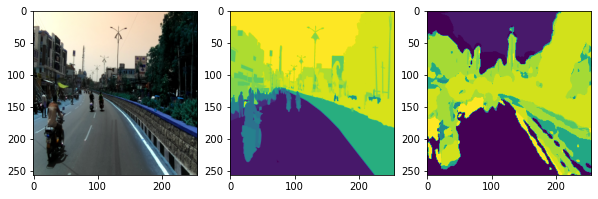

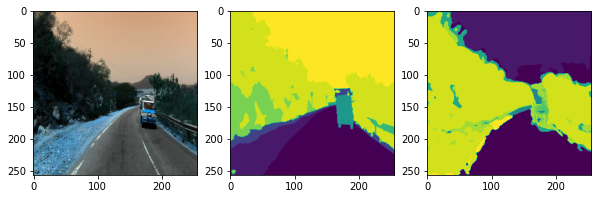

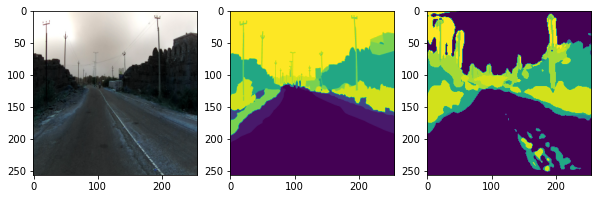

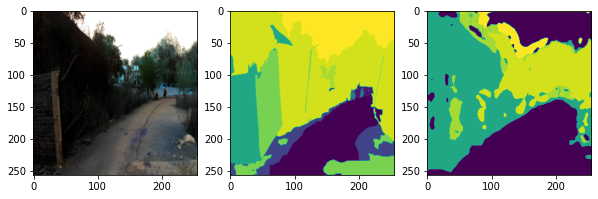

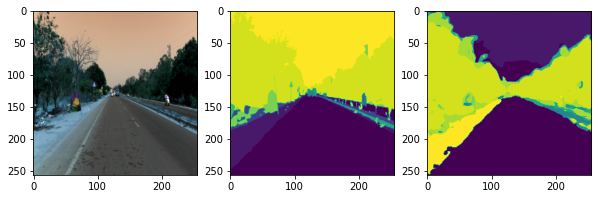

...

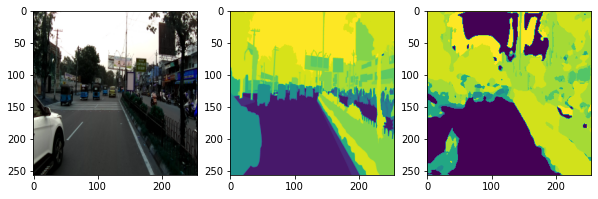

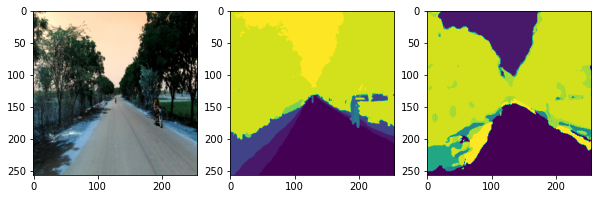

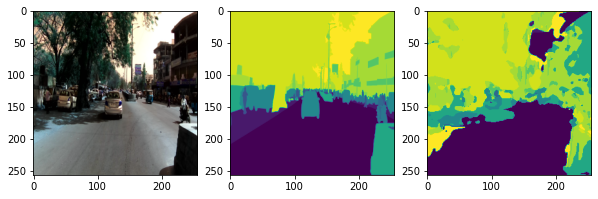

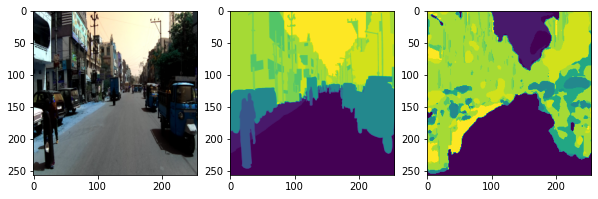

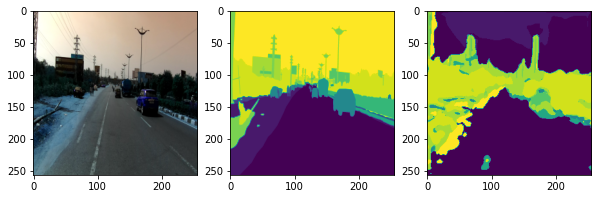

In [17]:
count=0
for i in range(len(X_test)):
  image = cv2.imread(list(X_test['images'])[i], cv2.IMREAD_UNCHANGED)
  image = cv2.resize(image, (256,256),interpolation = cv2.INTER_AREA)

  #predicted mask
  pred_mask = model.predict(image[np.newaxis,:,:,:])
  pred_mask = tf.argmax(pred_mask, axis=-1)

  # original mask
  image_mask = cv2.imread(list(X_test['mask'])[i], cv2.IMREAD_UNCHANGED)
  image_mask = cv2.resize(image_mask, (256,256),interpolation = cv2.INTER_AREA)

  plt.figure(figsize=(10,6))
  plt.subplot(131)
  plt.imshow(image)
  plt.subplot(132)
  plt.imshow(image_mask) 
  plt.subplot(133)
  plt.imshow(pred_mask[0])
  plt.show()
  count+=1
  if count==20:
    break
 
    

# Task 3: Training CANet

Taken help from https://github.com/AtharvaMusale/Semantic-Segmentation-on-Indian-Driving-Dataset/blob/main/Semantic%20Segmentation%20On%20IDD.ipynb


In [6]:
import tensorflow as tf
# tf.compat.v1.enable_eager_execution()
from tensorflow import keras
from tensorflow.keras.layers import *
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import UpSampling2D
from tensorflow.keras.layers import MaxPooling2D, GlobalAveragePooling2D
from tensorflow.keras.layers import concatenate
from tensorflow.keras.layers import Multiply
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Add, Dense, Activation, ZeroPadding2D, BatchNormalization, Flatten, Conv2D, AveragePooling2D, MaxPooling2D, GlobalMaxPooling2D
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.utils import plot_model
from tensorflow.keras.initializers import glorot_uniform
K.set_image_data_format('channels_last')
K.set_learning_phase(1)

/usr/local/lib/python3.7/dist-packages/keras/backend.py:414: UserWarning: `tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.
  warnings.warn('`tf.keras.backend.set_learning_phase` is deprecated and '


* as a part of this assignment we will be implementing the architecture based on this paper https://arxiv.org/pdf/2002.12041.pdf
* We will be using the custom layers concept that we used in seq-seq assignment
* You can devide the whole architecture can be devided into two parts
    1. Encoder
    2. Decoder
    <img src='https://i.imgur.com/prH3Mno.png' width="600">
* Encoder:
    * The first step of the encoder is to create the channel map  [$C_1$, $C_2$, $C_3$, $C_4$]
    * $C_1$ width and heigths are 4x times less than the original image
    * $C_2$ width and heigths are 8x times less than the original image
    * $C_3$ width and heigths are 8x times less than the original image
    * $C_4$ width and heigths are 8x times less than the original image
    * <i>you can reduce the dimensions by using stride parameter</i>.
    * [$C_1$, $C_2$, $C_3$, $C_4$] are formed by applying a "conv block" followed by $k$ number of "identity block". i.e the $C_k$ feature map will single "conv block" followed by $k$ number of "identity blocks".
    <table>
    <tr><td><img src="https://i.imgur.com/R8Gdypo.png" width="300"></td>
        <td><img src="https://i.imgur.com/KNunjQK.png" width="250"></td></tr>
    </table>
    * <strong>The conv block and identity block of $C_1$</strong>: the number filters in the covolutional layers will be $[4,4,8]$ and the number of filters in the parallel conv layer will also be $8$.
    * <strong>The conv block and identity block of $C_2$</strong>: the number filters in the covolutional layers will be $[8,8,16]$ and the number of filters in the parallel conv layer will also be $16$.
    * <strong>The conv block and identity block of $C_3$</strong>: the number filters in the covolutional layers will be $[16,16,32]$ and the number of filters in the parallel conv layer will also be $32$.
    * <strong>The conv block and identity block of $C_4$</strong>: the number filters in the covolutional layers will be $[32,32,64]$ and the number of filters in the parallel conv layer will also be $64$.
    * Here $\oplus$ represents the elementwise sum
    <br>
    
    <font color="red">NOTE: these filters are of your choice, you can explore more options also</font>
    
    * Example: if your image is of size $(512, 512, 3)$
        * the output after $C_1$ will be $128*128*8$
        * the output after $C_2$ will be $64*64*16$
        * the output after $C_3$ will be $64*64*32$
        * the output after $C_4$ will be $64*64*64$

In [7]:
class convolutional_block(tf.keras.layers.Layer):
    def __init__(self, kernel=3,  filters=[4,4,8], stride=1, name="conv block"):
        super().__init__(name=name)
        self.F1, self.F2, self.F3 = filters
        self.kernel = kernel
        self.stride = stride
        self.conv_layer_1 = Conv2D(self.F1,(1,1),strides=(self.stride,self.stride),kernel_initializer='he_normal')
        self.b1 = BatchNormalization()
        self.a1 = Activation('relu')
        self.conv_layer_2 = Conv2D(self.F2,(self.kernel,self.kernel),padding='same',kernel_initializer='he_normal')
        self.b2 = BatchNormalization()
        self.a2 = Activation('relu')
        self.conv_layer_3 = Conv2D(self.F3,(1,1),padding='valid',kernel_initializer='he_normal')
        self.b3 = BatchNormalization()
        self.parallel_conv_layer = Conv2D(self.F3,(self.kernel,self.kernel),strides=(self.stride,self.stride),kernel_initializer='he_normal',padding='same')
        self.parallel_b = BatchNormalization()
        self.parallel_a = Activation('relu')
        self.add = Add()
        self.final_activation = Activation('relu')
    def call(self, X):
        # write the architecutre that was mentioned above
        conv_layer = self.conv_layer_1(X)
        bn_layer = self.b1(conv_layer)
        activation = self.a1(bn_layer)
        conv_layer_2 = self.conv_layer_2(activation)
        bn_layer_2 = self.b2(conv_layer_2)
        activation_2 = self.a2(bn_layer_2)
        conv_layer_3 = self.conv_layer_3(activation_2)
        bn_layer_3 = self.b3(conv_layer_3)

        parallel_conv_block = self.parallel_conv_layer (X)
        parallel_bn_layer = self.parallel_b(parallel_conv_block)
        parallel_activation = self.parallel_a(parallel_bn_layer)
        concat_layer = self.add((bn_layer_3,parallel_activation))
        X =self.final_activation(concat_layer)

        return X

In [8]:
class identity_block(tf.keras.layers.Layer):
    def __init__(self, kernel=3,  filters=[4,4,8], name="identity block"):
        super().__init__(name=name)
        self.F1, self.F2, self.F3 = filters
        self.kernel = kernel
        self.conv_layer_1 = Conv2D(self.F1,(1,1),kernel_initializer='he_normal')
        self.b1 = BatchNormalization()
        self.a1 = Activation('relu')
        self.conv_layer_2 = Conv2D(self.F2,(self.kernel,self.kernel),padding='same',kernel_initializer='he_normal')
        self.b2 = BatchNormalization()
        self.a2 = Activation('relu')
        self.conv_layer_3 = Conv2D(self.F3,(1,1),padding='valid',kernel_initializer='he_normal')
        self.b3 = BatchNormalization()
        self.add_layer = Add()
        self.final_activation = Activation('relu')
        
    def call(self, X):
        # write the architecutre that was mentioned above
        conv_layer = self.conv_layer_1(X)
        bn_layer = self.b1(conv_layer)
        activation = self.a1(bn_layer)
        conv_layer_2 = self.conv_layer_2(activation)
        bn_layer_2 = self.b2(conv_layer_2)
        activation_2 = Activation('relu')(bn_layer_2)
        conv_layer_3 = self.conv_layer_3(activation_2)
        bn_layer_3 = self.b3(conv_layer_3)

        concat_layer = self.add_layer((bn_layer_3,X))
        X = self.final_activation(concat_layer)


        return X

* The output of the $C_4$ will be passed to $\text{Chained Context Aggregation Module (CAM)}$
<img src='https://i.imgur.com/Bu63AAA.png' width="400">
* The CAM module will have two operations names Context flow and Global flow
* <strong>The Global flow</strong>: 
    * as shown in the above figure first we willl apply  <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/GlobalAveragePooling2D">global avg pooling</a> which results in (#, 1, 1, number_of_filters) then applying <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/BatchNormalization?version=nightly">BN</a>, <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/ReLU">RELU</a>, $1*1 \text{ Conv}$ layer sequentially which results a matrix (#, 1, 1, number_of_filters). Finally apply <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/UpSampling2D">upsampling</a> / <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/Conv2DTranspose">conv2d transpose</a> to make the output same as the input dimensions (#, input_height, input_width, number_of_filters)
    * If you use <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/UpSampling2D">upsampling</a> then use bilinear pooling as interpolation technique
* <strong>The Context flow</strong>: 
    * as shown in the above figure (c) the context flow will get inputs from two modules `a. C4` `b. From the above flow` 
    * We will be <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/Concatenate">concatinating</a> the both inputs on the last axis.
    * After the concatination we will be applying <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/AveragePooling2D"> Average pooling </a> which reduces the size of feature map by $N\times$ times
    * In the paper it was mentioned that to apply a group convolutions, but for the assignment we will be applying the simple conv layers with kernel size $(3*3)$
    * We are skipping the channel shuffling 
    * similarly we will be applying a simple conv layers with kernel size $(3*3)$ consider this output is X
    * later we will get the Y=(X $\otimes \sigma((1\times1)conv(relu((1\times1)conv(X))))) \oplus X$, here $\oplus$ is elementwise addition and $\otimes$ is elementwise multiplication
    * Finally apply <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/UpSampling2D">upsampling</a> / <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/Conv2DTranspose">conv2d transpose</a> to make the output same as the input dimensions (#, input_height, input_width, number_of_filters)
    * If you use <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/UpSampling2D">upsampling</a> then use bilinear pooling as interpolation technique

NOTE: here N times reduction and N time increments makes the input and out shape same, you can explore with the N values, you can choose N = 2 or 4

* Example with N=2:
    * Assume the C4 is of shape (64,64,64) then the shape of GF will be (64,64,32)
    * Assume the C4 is of shape (64,64,64) and the shape of GF is (64,64,32) then the shape of CF1 will be (64,64,32)
    * Assume the C4 is of shape (64,64,64) and the shape of CF1 is (64,64,32) then the shape of CF2 will be (64,64,32)
    * Assume the C4 is of shape (64,64,64) and the shape of CF2 is (64,64,32) then the shape of CF3 will be (64,64,32)

In [9]:
class global_flow(tf.keras.layers.Layer):
    def __init__(self,kernel=64,filter = 64,name="global_flow"):
        super().__init__(name=name)
        self.g1 = GlobalAveragePooling2D(keepdims=True)
        self.b1 = BatchNormalization()
        self.a1 = Activation('relu')
        self.kernel = kernel
        self.filter = filter
        self.conv_layer = Conv2D(self.filter,(1,1),padding='same',activation='relu')
        self.up_layer = UpSampling2D(size=(self.kernel,self.kernel),interpolation='bilinear')
        
    def call(self, X):
        # implement the global flow operatiom
        global_average_pooling_layer = self.g1(X)
        batch_normalising_layer = self.b1(global_average_pooling_layer)
        activation_layer = self.a1(batch_normalising_layer)
        conv_layer = self.conv_layer(activation_layer)
        up_sample_layer = self.up_layer(conv_layer)
        
        
        return up_sample_layer

In [10]:
class context_flow(tf.keras.layers.Layer):    
    def __init__(self,filters=32, name="context_flow"):
        super().__init__(name=name)
        self.conc = Concatenate()
        self.filter = filters
        self.avg_pool = AveragePooling2D()
        self.conv_11 = Conv2D(self.filter,(3,3),padding='same',activation='relu',kernel_initializer='he_normal')
        self.conv_12 = Conv2D(self.filter,(3,3),padding='same',activation='relu',kernel_initializer='he_normal')
        self.conv_21 = Conv2D(self.filter,(1,1),activation='relu',padding='same',kernel_initializer='he_normal')
        self.conv_22 = Conv2D(self.filter,(1,1),padding='same',kernel_initializer='glorot_normal')
        self.mul = Multiply()
        self.add = Add()
        self.up_sample = UpSampling2D(size=(2,2),interpolation='bilinear')
    def call(self, X):
        # here X will a list of two elements 
        INP, FLOW = X[0], X[1] 
        # implement the context flow as mentioned in the above cell
        # Context fusion module
        concat_input = self.conc([INP,FLOW])
        pooled_layer_output = self.avg_pool(concat_input)
        conv_layer = self.conv_11(pooled_layer_output)
        conv_layer_2 = self.conv_12(conv_layer)

        # Context refinement module
        conv_layer_c = self.conv_21(conv_layer_2)
        conv_layer_c2 = self.conv_22(conv_layer_c)

        # Multipling
        mul_layer = self.mul([conv_layer_c2,conv_layer_2])
        # Adding
        add_layer = self.add([mul_layer,conv_layer_2])
        ans_layer = self.up_sample(add_layer)


        return ans_layer

* As shown in the above architecture we will be having 4 context flows
* if you have implemented correctly all the shapes of Global Flow, and 3 context flows will have the same dimension
* the output of these 4 modules will be <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/Add">added</a> to get the same output matrix
<img src='https://i.imgur.com/Bu63AAA.png' width="400">
 * The output of after the sum, will be sent to the <strong>Feature selection module $FSM$</strong>
 
* Example:
    * if the shapes of GF, CF1, CF2, CF3 are (64,64,32), (64,64,32), (64,64,32), (64,64,32), (64,64,32) respectivly then after the sum we will be getting (64,64,32), which will be passed to the next module.
 
<strong>Feature selection module</strong>:

* As part of the FSM we will be applying a conv layer (3,3) with the padding="same" so that the output and input will have same shapes
* Let call the output as X
* Pass the X to global pooling which results the matrix (#, 1, 1, number_of_channels)
* Apply $1*1$ conv layer, after the pooling
* the output of the $1*1$ conv layer will be passed to the Batch normalization layer, followed by Sigmoid activation function.
* we will be having the output matrix of shape (#, 1, 1, number_of_channels) lets call it 'Y'
* <strong>we can interpret this as attention mechanisum, i.e for each channel we will having a weight</strong>
* the dimension of X (#, w, h, k) and output above steps Y is (#, 1, 1, k) i.e we need to multiply each channel of X will be <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/Multiply">multiplied</a> with corresponding channel of Y
* After creating the weighted channel map we will be doing upsampling such that it will double the height and width.
* apply <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/UpSampling2D">upsampling</a> with bilinear pooling as interpolation technique

* <font color="red">Example</font>:
    * Assume the matrix shape of the input is (64,64,32) then after upsampling it will be (128,128,32)

In [11]:
class fsm(tf.keras.layers.Layer):    
    def __init__(self,filter = 32, name="feature_selection"):
        super().__init__(name=name)
        self.filter = filter
        self.conv_layer = Conv2D(256,(3,3),padding='same',kernel_initializer='he_normal')
        self.glob_layer = GlobalAveragePooling2D(keepdims=True)
        self.conv_layer_2 = Conv2D(256,(1,1),padding='same',kernel_initializer='he_normal')
        self.b1 = BatchNormalization()
        self.a1 = Activation('sigmoid')
        self.mul = Multiply()
        self.up = UpSampling2D(interpolation='bilinear',size=(2,2))

        
    def call(self, X):
        # implement the FSM modules based on image in the above cells
        conv_layer = self.conv_layer(X)
        global_pool_layer = self.glob_layer(conv_layer)
        conv_layer_2 = self.conv_layer_2(global_pool_layer)
        batch_norm_layer = self.b1(conv_layer_2)
        activation_layer = self.a1(batch_norm_layer)

        mul_layer = self.mul([activation_layer,conv_layer])
        FSM_Conv_T = self.up(mul_layer)
        return FSM_Conv_T

* <b>Adapted Global Convolutional Network (AGCN)</b>:
    <img src="https://i.imgur.com/QNB8RmV.png" width="300">
    
    * AGCN will get the input from the output of the "conv block" of $C_1$
    
    * In all the above layers we will be using the padding="same" and stride=(1,1)
    
    * so that we can have the input and output matrices of same size
    
* <font color="red">Example</font>:
    * Assume the matrix shape of the input is (128,128,32) then the output it will be (128,128,32)

In [12]:
class agcn(tf.keras.layers.Layer):    
    def __init__(self,filter = 32, name="global_conv_net"):
        super().__init__(name=name)
        self.filter = filter
        self.conv_11 = Conv2D(self.filter,(7,1),padding='same')
        self.conv_21 = Conv2D(self.filter,(1,7),padding='same')
        self.conv_12 = Conv2D(self.filter,(1,7),padding='same')
        self.conv_22 = Conv2D(self.filter,(7,1),padding='same')
        self.add = Add()
        self.conv = Conv2D(self.filter,(3,3),padding='same')
        self.add_2 = Add()
        
    def call(self, X):
        # please implement the above mentioned architecture
        conv_layer_11 = self.conv_11(X)
        conv_layer_21 = self.conv_21(conv_layer_11)

        conv_layer_12 = self.conv_12(X)
        conv_layer_22 = self.conv_22(conv_layer_12)

        add_layer = self.add([conv_layer_21,conv_layer_22])

        conv_layer = self.conv(add_layer)

        final_layer = self.add_2([add_layer,conv_layer])
        return final_layer

*     <img src='https://i.imgur.com/prH3Mno.png' width="600">
* as shown in the architecture, after we get the AGCN it will get concatinated with the FSM output

* If we observe the shapes both AGCN and FSM will have same height and weight

* we will be concatinating both these outputs over the last axis

* The concatinated output will be passed to a conv layers with filters = number of classes in our data set and the activation function = 'relu'

* we will be using padding="same" which results in the same size feature map

* If you observe the shape of matrix, it will be 4x times less than the original image

* to make it equal to the original output shape, we will do 4x times upsampling of rows and columns

* apply <a href="https://www.tensorflow.org/api_docs/python/tf/keras/layers/UpSampling2D">upsampling</a> with bilinear pooling as interpolation technique

* Finally we will be applying sigmoid activation.

* Example:
    * Assume the matrix shape of AGCN is (128,128,32)  and FSM is (128,128,32) the concatination will make it (128, 128, 64)
    * Applying conv layer will make it (128,128,21)
    * Finally applying upsampling will make it (512, 512, 21)
    * Applying sigmoid will result in the same matrix (512, 512, 21)

In [29]:
# Taken help from https://github.com/AtharvaMusale/Semantic-Segmentation-on-Indian-Driving-Dataset/blob/main/Semantic%20Segmentation%20On%20IDD.ipynb
tf.keras.backend.clear_session()
X_input = Input(shape=(512,512,3))

# Stage 1
X = Conv2D(256, (3, 3), name='conv1', padding="same", kernel_initializer=glorot_uniform(seed=0))(X_input)
X = BatchNormalization(axis=3, name='bn_conv1')(X)
X = Activation('relu')(X)
X = MaxPooling2D((2, 2), strides=(2, 2))(X)

X = convolutional_block(kernel=3,filters=[4,4,8],stride= 2,name  = 'conv_block1')(X)
X_C1 = X
X = identity_block(kernel = 3,filters=[4,4,8],name='identity_block11')(X)

X = convolutional_block(kernel=3,filters=[8,8,16],stride= 2,name  = 'conv_block2')(X)
X = identity_block(kernel = 3,filters=[8,8,16],name='identity_block21')(X)
X = identity_block(kernel = 3,filters=[8,8,16],name='identity_block22')(X)

X = convolutional_block(kernel=3,filters=[16,16,32],stride= 1,name  = 'conv_block3')(X)
X = identity_block(kernel = 3,filters=[16,16,32],name='identity_block31')(X)
X = identity_block(kernel = 3,filters=[16,16,32],name='identity_block32')(X)
X = identity_block(kernel = 3,filters=[16,16,32],name='identity_block33')(X)


X = convolutional_block(kernel=3,filters=[32,32,64],stride= 1,name  = 'conv_block4')(X)
X = identity_block(kernel = 3,filters=[32,32,64],name='identity_block41')(X)
X = identity_block(kernel = 3,filters=[32,32,64],name='identity_block42')(X)
X = identity_block(kernel = 3,filters=[32,32,64],name='identity_block43')(X)
X_id4 = identity_block(kernel = 3,filters=[32,32,64],name='identity_block44')(X)




filter_number = 64
# print(X_id4.shape)

X = global_flow(name = 'global_flow',filter=filter_number,kernel=X_id4.shape[1])(X_id4)
X_GF = X
X_CF1 = context_flow(filters=filter_number,name='context_flow1')([X_id4,X_GF])
X_CF2 = context_flow(filters=filter_number,name='context_flow2')([X_id4,X_CF1])
X_CF3 = context_flow(filters=filter_number,name='context_flow3')([X_id4,X_CF2])
# print(X.shape)
# print(X_CF1.shape)
# print(X_CF2.shape)
# print(X_CF3.shape)
added = add([X,X_CF1,X_CF2,X_CF3])
X_FSM = fsm(filter = filter_number,name='fsm_stage')(added)
X_agcn = agcn(filter = filter_number,name='agcn')(X_C1)
concat = Concatenate()([X_FSM,X_agcn])

# sub_conv = Dropout(0.1)(concat)
# sub_conv = Conv2D(64, (3, 3), padding='same', kernel_initializer='he_normal')(concat)
# sub_conv = Dropout(0.1)(sub_conv)
# sub_conv = BatchNormalization(axis=1)(sub_conv)
# sub_conv = Activation('relu')(sub_conv)

Final1 = Conv2D(21, (3, 3),activation='relu', padding = 'same', name = 'FinalBlock1')(concat)

o_Final  = UpSampling2D((4,4), interpolation = 'bilinear')(Final1)

Final = (Activation('softmax'))(o_Final)

canet_model = Model(inputs = X_input, outputs = Final, name='ResNet50')

print(Final.shape)

(None, 512, 512, 21)


* If you observe the arcitecture we are creating a feature map with 2x time less width and height
* we have written the first stage of the code above.
* Write the next layers by using the custom layers we have written

In [30]:
# write the complete architecutre
canet_model.summary()

Model: "ResNet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 512, 512, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1 (Conv2D)                 (None, 512, 512, 25  7168        ['input_1[0][0]']                
                                6)                                                                
                                                                                                  
 bn_conv1 (BatchNormalization)  (None, 512, 512, 25  1024        ['conv1[0][0]']                  
                                6)                                                         

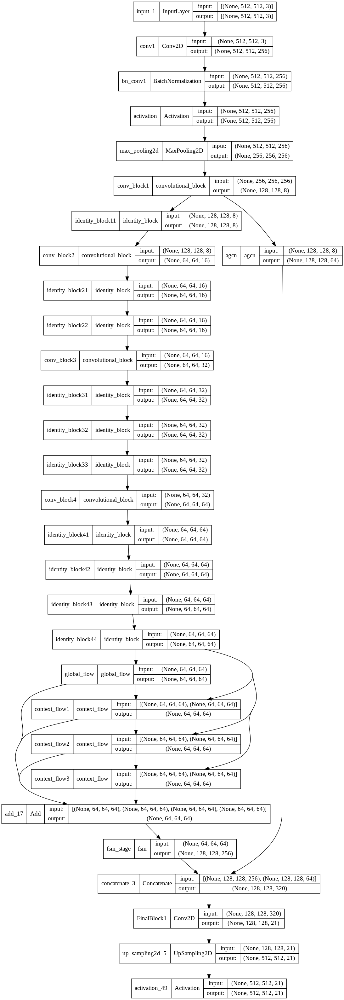

In [15]:
tf.keras.utils.plot_model(
    canet_model, to_file='model4.png', show_shapes=True, show_layer_names=True,
    rankdir='TB')

In [ ]:
# /content/drive/MyDrive/appliedai/assignment/assignment_29/data

In [16]:
# for copying content from drive to colab so that code can be executed fastly 
# !cp -a /content/drive/MyDrive/appliedai/assignment/assignment_29/preprocessed_data.csv /content/
# !cp -a /content/drive/MyDrive/appliedai/assignment/assignment_29/data /content/
# os.chdir('/content/')

In [17]:
data_df = pd.read_csv('preprocessed_data.csv')


In [18]:
# Deleting the images with zero btye sizes from dataframe
def cleanup(df):
    location_for_deleting_columns = []
    for i in range(df.shape[0]):
        fileSize = os.path.getsize(df['images'][i])
         # get integer value size in bytes of the file
        if fileSize == 0:
          location_for_deleting_columns.append(i)
    return data_df.drop(location_for_deleting_columns)
data_df = cleanup(data_df)           

In [19]:
from sklearn.model_selection import train_test_split
X_train, X_test = train_test_split(data_df, test_size=0.15, random_state=42)
aug1 = iaa.Fliplr(1)
aug2 = iaa.Flipud(1)
aug3 = iaa.Emboss(alpha=(1), strength=1)
aug4 = iaa.DirectedEdgeDetect(alpha=(0.8), direction=(1.0))


In [38]:

def visualize(**images):
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        if i==1:
            plt.imshow(image, cmap='gray', vmax=1, vmin=0)
        else:
            plt.imshow(image)
    plt.show()
    
def normalize_image(mask):
    mask = mask/255
    return mask

class Dataset:
    # we will be modifying this CLASSES according to your data/problems
    
    # the parameters needs to changed based on your requirements
    # here we are collecting the file_names because in our dataset, both our images and maks will have same file name
    # ex: fil_name.jpg   file_name.mask.jpg
    def __init__(self, path, file_name_image, file_name_mask, classes,training=True):
        
        self.image_ids = file_name_image
        self.mask_ids = file_name_mask
        # the paths of images
        self.images_fps   = [os.path.join(path, image_id) for image_id in self.image_ids]
        # the paths of segmentation images
        self.masks_fps    = [os.path.join(path, mask_id) for mask_id in self.mask_ids]
        # giving labels for each class
        self.classes = classes
        self.class_values = classes
        self.training=training

    
    def __getitem__(self, i):
        
        # read data
        image = cv2.imread(self.images_fps[i], cv2.IMREAD_UNCHANGED)
        image = cv2.resize(image,(512,512),interpolation=cv2.INTER_AREA)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)


        mask  = cv2.imread(self.masks_fps[i], cv2.IMREAD_UNCHANGED)
        image_mask = cv2.resize(mask,(512,512),cv2.INTER_NEAREST)
        image_masks = [(image_mask == v) for v in self.class_values]
        image_mask = np.stack(image_masks, axis=-1).astype('float')
        if self.training:
          a = np.random.uniform()
          if a<0.25:
              image = aug1.augment_image(image)
              image_mask = aug1.augment_image(image_mask)
          elif a<0.5:
              image = aug2.augment_image(image)
              image_mask = aug2.augment_image(image_mask)
          elif a<0.75:
              image = aug3.augment_image(image)
              image_mask = aug3.augment_image(image_mask)
          else:
              image = aug4.augment_image(image)
              image_mask = aug4.augment_image(image_mask)
            
        return image, image_mask
        
    def __len__(self):
        return len(self.image_ids)
    
    
class Dataloder(tf.keras.utils.Sequence):    
    def __init__(self, dataset, batch_size=1, shuffle=False):
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(dataset))

    def __getitem__(self, i):
        
        # collect batch data
        start = i * self.batch_size
        stop = (i + 1) * self.batch_size
        data = []
        for j in range(start, stop):
            data.append(self.dataset[j])
        
        batch = [np.stack(samples, axis=0) for samples in zip(*data)]
        
        return tuple(batch)
    
    def __len__(self):
        return len(self.indexes) // self.batch_size
    
    def on_epoch_end(self):
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)

In [21]:
!pip install segmentation_models

     |████████████████████████████████| 50 kB 4.7 MB/s 


In [31]:
# https://github.com/qubvel/segmentation_models
import os
import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt
# from hilbert import hilbertCurve
import imgaug.augmenters as iaa
import numpy as np
# import albumentations as A
os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'
import tensorflow as tf
import segmentation_models as sm
sm.set_framework('tf.keras')
tf.keras.backend.set_image_data_format('channels_last')
import segmentation_models as sm
from segmentation_models.metrics import IOUScore
iocscore = IOUScore(threshold=0.5)
optim = tf.keras.optimizers.Adam(0.001)
focal_loss = sm.losses.cce_dice_loss
canet_model.compile(optim, focal_loss, metrics=[iocscore])
tf.config.run_functions_eagerly(True)


In [23]:
label_clr = {'road':10, 'parking':20, 'drivable fallback':20,'sidewalk':30,'non-drivable fallback':40,'rail track':40,\
                        'person':50, 'animal':50, 'rider':60, 'motorcycle':70, 'bicycle':70, 'autorickshaw':80,\
                        'car':80, 'truck':90, 'bus':90, 'vehicle fallback':90, 'trailer':90, 'caravan':90,\
                        'curb':100, 'wall':100, 'fence':110,'guard rail':110, 'billboard':120,'traffic sign':120,\
                        'traffic light':120, 'pole':130, 'polegroup':130, 'obs-str-bar-fallback':130,'building':140,\
                        'bridge':140,'tunnel':140, 'vegetation':150, 'sky':160, 'fallback background':160,'unlabeled':0,\
                        'out of roi':0, 'ego vehicle':170, 'ground':180,'rectification border':190,\
                   'train':200}

In [40]:
from tensorflow.keras.callbacks import TensorBoard,ModelCheckpoint,ReduceLROnPlateau
import time
classes = list(np.unique(list(label_clr.values())))
dir_path = ''
train_dataset = Dataset(dir_path,X_train['images'].values, X_train['mask'].values,classes=classes)
test_dataset = Dataset(dir_path,X_test['images'].values,X_test['mask'].values,classes=classes,training=False)
BATCH_SIZE=2
train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
test_dataloader = Dataloder(test_dataset, batch_size=BATCH_SIZE, shuffle=True)
print(train_dataloader[0][0].shape)
print(train_dataloader[0][1].shape)
tensorboard_callback = TensorBoard(log_dir="/content/drive/MyDrive/appliedai/assignment/assignment_29/canet_model/content/logs/", histogram_freq=1, write_graph=True)
modelcheckpoint_callback = keras.callbacks.ModelCheckpoint('/content/drive/MyDrive/appliedai/assignment/assignment_29/canet_model/'+'checkpoint_{epoch:02d}', save_freq='epoch')

callback_list = [tensorboard_callback,modelcheckpoint_callback]





(2, 512, 512, 3)
(2, 512, 512, 21)


In [27]:
tf.get_logger().setLevel('ERROR')


In [32]:
canetModel = canet_model.fit(train_dataloader, 
                             steps_per_epoch=len(train_dataloader), 
                             epochs=10,
                             validation_data=test_dataloader, 
                             callbacks=callback_list)


/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/dataset_ops.py:4527: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  "Even though the `tf.config.experimental_run_functions_eagerly` "


Epoch 1/10
1019/1019 [==============================] - ETA: 0s - loss: 0.9597 - iou_score: 0.2855

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 477s 468ms/step - loss: 0.9597 - iou_score: 0.2855 - val_loss: 0.9533 - val_iou_score: 0.2866
Epoch 2/10
1019/1019 [==============================] - ETA: 0s - loss: 0.9154 - iou_score: 0.3114

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 469s 460ms/step - loss: 0.9154 - iou_score: 0.3114 - val_loss: 1.2202 - val_iou_score: 0.1760
Epoch 3/10
1019/1019 [==============================] - ETA: 0s - loss: 0.9000 - iou_score: 0.3146

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 469s 460ms/step - loss: 0.9000 - iou_score: 0.3146 - val_loss: 0.9089 - val_iou_score: 0.3192
Epoch 4/10
1019/1019 [==============================] - ETA: 0s - loss: 0.8876 - iou_score: 0.3202

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 473s 464ms/step - loss: 0.8876 - iou_score: 0.3202 - val_loss: 0.9277 - val_iou_score: 0.2649
Epoch 5/10
1019/1019 [==============================] - ETA: 0s - loss: 0.8860 - iou_score: 0.3230

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 470s 461ms/step - loss: 0.8860 - iou_score: 0.3230 - val_loss: 0.9075 - val_iou_score: 0.3104
Epoch 6/10
1019/1019 [==============================] - ETA: 0s - loss: 0.8769 - iou_score: 0.3188

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 464s 455ms/step - loss: 0.8769 - iou_score: 0.3188 - val_loss: 0.9568 - val_iou_score: 0.2685
Epoch 7/10
1019/1019 [==============================] - ETA: 0s - loss: 0.8755 - iou_score: 0.3122

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 464s 455ms/step - loss: 0.8755 - iou_score: 0.3122 - val_loss: 0.8786 - val_iou_score: 0.3167
Epoch 8/10
1019/1019 [==============================] - ETA: 0s - loss: 0.8652 - iou_score: 0.3148

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 455s 446ms/step - loss: 0.8652 - iou_score: 0.3148 - val_loss: 0.9669 - val_iou_score: 0.2598
Epoch 9/10
1019/1019 [==============================] - ETA: 0s - loss: 0.8579 - iou_score: 0.3256

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 460s 451ms/step - loss: 0.8579 - iou_score: 0.3256 - val_loss: 0.8759 - val_iou_score: 0.3117
Epoch 10/10
1019/1019 [==============================] - ETA: 0s - loss: 0.8554 - iou_score: 0.3190

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 466s 457ms/step - loss: 0.8554 - iou_score: 0.3190 - val_loss: 0.8853 - val_iou_score: 0.3081


In [33]:
canet_model.optimizer.lr = 0.0001
canetModel = canet_model.fit(train_dataloader, 
                             steps_per_epoch=len(train_dataloader), 
                             initial_epoch=10,
                             epochs=25,
                             validation_data=test_dataloader, 
                             callbacks=callback_list)


/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/dataset_ops.py:4527: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  "Even though the `tf.config.experimental_run_functions_eagerly` "


Epoch 11/25
1019/1019 [==============================] - ETA: 0s - loss: 0.8362 - iou_score: 0.3367

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 457s 448ms/step - loss: 0.8362 - iou_score: 0.3367 - val_loss: 0.8334 - val_iou_score: 0.3459
Epoch 12/25
1019/1019 [==============================] - ETA: 0s - loss: 0.8257 - iou_score: 0.3460

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 454s 445ms/step - loss: 0.8257 - iou_score: 0.3460 - val_loss: 0.8270 - val_iou_score: 0.3478
Epoch 13/25
1019/1019 [==============================] - ETA: 0s - loss: 0.8221 - iou_score: 0.3422

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 458s 449ms/step - loss: 0.8221 - iou_score: 0.3422 - val_loss: 0.8384 - val_iou_score: 0.3338
Epoch 14/25
1019/1019 [==============================] - ETA: 0s - loss: 0.8193 - iou_score: 0.3456

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 454s 445ms/step - loss: 0.8193 - iou_score: 0.3456 - val_loss: 0.8176 - val_iou_score: 0.3554
Epoch 15/25
1019/1019 [==============================] - ETA: 0s - loss: 0.8168 - iou_score: 0.3472

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 461s 452ms/step - loss: 0.8168 - iou_score: 0.3472 - val_loss: 0.8259 - val_iou_score: 0.3497
Epoch 16/25
1019/1019 [==============================] - ETA: 0s - loss: 0.8153 - iou_score: 0.3508

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 456s 447ms/step - loss: 0.8153 - iou_score: 0.3508 - val_loss: 0.8323 - val_iou_score: 0.3452
Epoch 17/25
1019/1019 [==============================] - ETA: 0s - loss: 0.8140 - iou_score: 0.3497

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 453s 445ms/step - loss: 0.8140 - iou_score: 0.3497 - val_loss: 0.8338 - val_iou_score: 0.3381
Epoch 18/25
1019/1019 [==============================] - ETA: 0s - loss: 0.8116 - iou_score: 0.3525

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 455s 446ms/step - loss: 0.8116 - iou_score: 0.3525 - val_loss: 0.8282 - val_iou_score: 0.3423
Epoch 19/25
1019/1019 [==============================] - ETA: 0s - loss: 0.8158 - iou_score: 0.3487

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 465s 456ms/step - loss: 0.8158 - iou_score: 0.3487 - val_loss: 0.8252 - val_iou_score: 0.3476
Epoch 20/25
1019/1019 [==============================] - ETA: 0s - loss: 0.8105 - iou_score: 0.3454

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 471s 462ms/step - loss: 0.8105 - iou_score: 0.3454 - val_loss: 0.8279 - val_iou_score: 0.3326
Epoch 21/25
1019/1019 [==============================] - ETA: 0s - loss: 0.8086 - iou_score: 0.3290

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 471s 463ms/step - loss: 0.8086 - iou_score: 0.3290 - val_loss: 0.8195 - val_iou_score: 0.3399
Epoch 22/25
1019/1019 [==============================] - ETA: 0s - loss: 0.8090 - iou_score: 0.3279

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 466s 457ms/step - loss: 0.8090 - iou_score: 0.3279 - val_loss: 0.8117 - val_iou_score: 0.3341
Epoch 23/25
1019/1019 [==============================] - ETA: 0s - loss: 0.8033 - iou_score: 0.3276

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 475s 466ms/step - loss: 0.8033 - iou_score: 0.3276 - val_loss: 0.8106 - val_iou_score: 0.3482
Epoch 24/25
1019/1019 [==============================] - ETA: 0s - loss: 0.8044 - iou_score: 0.3283

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 473s 464ms/step - loss: 0.8044 - iou_score: 0.3283 - val_loss: 0.8241 - val_iou_score: 0.3233
Epoch 25/25
1019/1019 [==============================] - ETA: 0s - loss: 0.8070 - iou_score: 0.3212

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 472s 463ms/step - loss: 0.8070 - iou_score: 0.3212 - val_loss: 0.8219 - val_iou_score: 0.3293


In [43]:
canet_model.optimizer.lr = 0.00001
canetModel = canet_model.fit(train_dataloader, 
                             steps_per_epoch=len(train_dataloader), 
                             initial_epoch=25,
                             epochs=27,
                             validation_data=test_dataloader, 
                             callbacks=callback_list)


/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/dataset_ops.py:4527: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  "Even though the `tf.config.experimental_run_functions_eagerly` "


Epoch 26/27
1019/1019 [==============================] - ETA: 0s - loss: 0.8078 - iou_score: 0.3574

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 453s 445ms/step - loss: 0.8078 - iou_score: 0.3574 - val_loss: 0.7991 - val_iou_score: 0.3886
Epoch 27/27
1019/1019 [==============================] - ETA: 0s - loss: 0.8094 - iou_score: 0.3585

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 454s 446ms/step - loss: 0.8094 - iou_score: 0.3585 - val_loss: 0.7988 - val_iou_score: 0.3892


In [44]:
canet_model.optimizer.lr = 0.000001
canetModel = canet_model.fit(train_dataloader, 
                             steps_per_epoch=len(train_dataloader), 
                             initial_epoch=27,
                             epochs=30,
                             validation_data=test_dataloader, 
                             callbacks=callback_list)


/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/dataset_ops.py:4527: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  "Even though the `tf.config.experimental_run_functions_eagerly` "


Epoch 28/30
1019/1019 [==============================] - ETA: 0s - loss: 0.8081 - iou_score: 0.3582

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 461s 453ms/step - loss: 0.8081 - iou_score: 0.3582 - val_loss: 0.7990 - val_iou_score: 0.3866
Epoch 29/30
1019/1019 [==============================] - ETA: 0s - loss: 0.8071 - iou_score: 0.3574

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 465s 456ms/step - loss: 0.8071 - iou_score: 0.3574 - val_loss: 0.7980 - val_iou_score: 0.3883
Epoch 30/30
1019/1019 [==============================] - ETA: 0s - loss: 0.8073 - iou_score: 0.3590

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 464s 455ms/step - loss: 0.8073 - iou_score: 0.3590 - val_loss: 0.7975 - val_iou_score: 0.3886


In [45]:
canet_model.optimizer.lr = 0.0000005
canetModel = canet_model.fit(train_dataloader, 
                             steps_per_epoch=len(train_dataloader), 
                             initial_epoch=30,
                             epochs=35,
                             validation_data=test_dataloader, 
                             callbacks=callback_list)


/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/dataset_ops.py:4527: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  "Even though the `tf.config.experimental_run_functions_eagerly` "


Epoch 31/35
1019/1019 [==============================] - ETA: 0s - loss: 0.8091 - iou_score: 0.3563

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 464s 455ms/step - loss: 0.8091 - iou_score: 0.3563 - val_loss: 0.7974 - val_iou_score: 0.3906
Epoch 32/35
1019/1019 [==============================] - ETA: 0s - loss: 0.8063 - iou_score: 0.3600

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 464s 455ms/step - loss: 0.8063 - iou_score: 0.3600 - val_loss: 0.7999 - val_iou_score: 0.3866
Epoch 33/35
1019/1019 [==============================] - ETA: 0s - loss: 0.8060 - iou_score: 0.3598

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 466s 457ms/step - loss: 0.8060 - iou_score: 0.3598 - val_loss: 0.7974 - val_iou_score: 0.3887
Epoch 34/35
1019/1019 [==============================] - ETA: 0s - loss: 0.8059 - iou_score: 0.3592

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 463s 454ms/step - loss: 0.8059 - iou_score: 0.3592 - val_loss: 0.7981 - val_iou_score: 0.3889
Epoch 35/35
1019/1019 [==============================] - ETA: 0s - loss: 0.8065 - iou_score: 0.3586

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


1019/1019 [==============================] - 460s 452ms/step - loss: 0.8065 - iou_score: 0.3586 - val_loss: 0.7974 - val_iou_score: 0.3902


In [ ]:
canet_model.save_weights('/content/drive/MyDrive/appliedai/assignment/assignment_29/canet_model/canet_best_uptill_now.h5')

In [42]:
canet_model.load_weights('/content/drive/MyDrive/appliedai/assignment/assignment_29/canet_model/checkpoint_18')

getting the best ioc score of 0.39 on validation set

In [18]:
%load_ext tensorboard
%tensorboard --logdir '/content/drive/MyDrive/appliedai/assignment/assignment_29/canet_model/content/logs/'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/dataset_ops.py:4527: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  "Even though the `tf.config.experimental_run_functions_eagerly` "


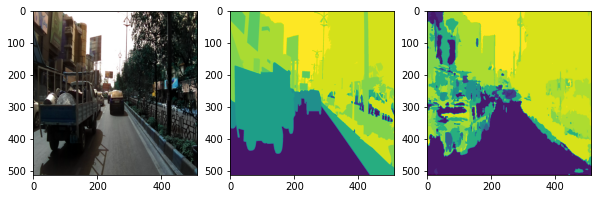

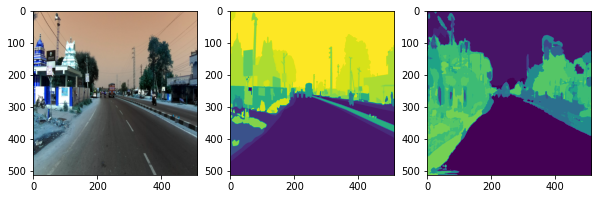

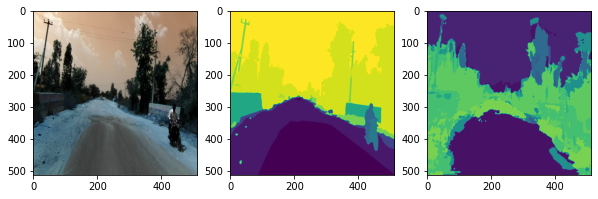

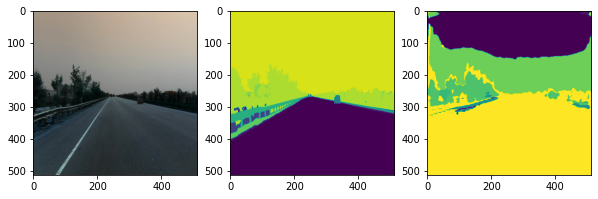

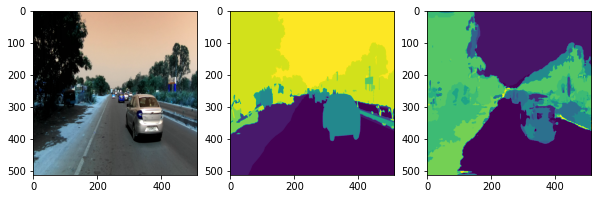

...

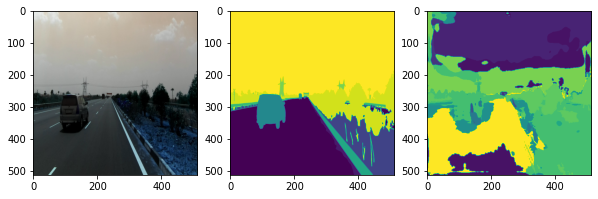

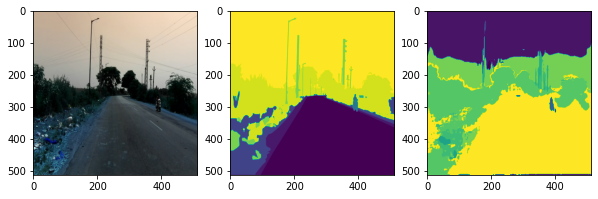

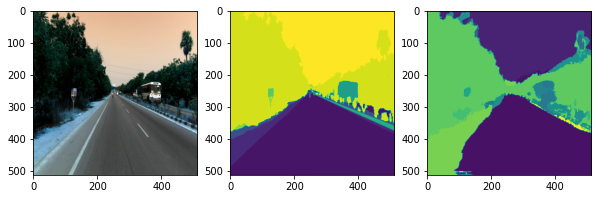

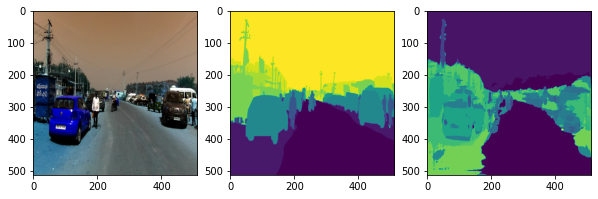

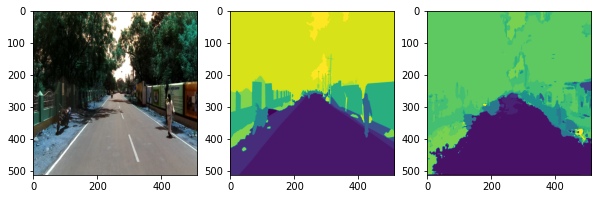

In [46]:
count=0
for i in range(len(X_test)):
  image = cv2.imread(list(X_test['images'])[i], cv2.IMREAD_UNCHANGED)
  image = cv2.resize(image, (512,512),interpolation = cv2.INTER_AREA)

  #predicted mask
  pred_mask = canet_model.predict(image[np.newaxis,:,:,:])
  pred_mask = tf.argmax(pred_mask, axis=-1)

  # original mask
  image_mask = cv2.imread(list(X_test['mask'])[i], cv2.IMREAD_UNCHANGED)
  image_mask = cv2.resize(image_mask, (512,512),interpolation = cv2.INTER_AREA)

  plt.figure(figsize=(10,6))
  plt.subplot(131)
  plt.imshow(image)
  plt.subplot(132)
  plt.imshow(image_mask) 
  plt.subplot(133)
  plt.imshow(pred_mask[0])
  plt.show()
  count+=1
  if count==20:
    break
 
    